# Geodemographic Analysis with PySAL and scikit-learn

Here, we'll examine geodemographic clustering in Los Angeles County

In [1]:
%load_ext watermark

In [2]:
%watermark -v -a "author: eli knaap" -d -u -p segregation,libpysal,geopandas

Author: author: eli knaap

Last updated: 2024-02-11

Python implementation: CPython
Python version       : 3.11.0
IPython version      : 8.21.0

segregation: 2.5
libpysal   : 4.9.2
geopandas  : 0.14.3



In [3]:
import geopandas as gpd
import geoviews as gv
import hvplot.pandas
import matplotlib.pyplot as plt
import seaborn as sns
from libpysal import weights
from sklearn.cluster import AffinityPropagation, AgglomerativeClustering, KMeans
from sklearn.preprocessing import MinMaxScaler, StandardScaler

## Data Prep

In [4]:
scag = gpd.read_file("data/scag_region.gpkg", layer="tracts")

In [5]:
scag = scag.fillna(0)

/var/folders/79/cknfb1sx2pv16rztkpg6wzlw0000gn/T/ipykernel_23646/251021088.py:1: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  scag = scag.fillna(0)


<Axes: >

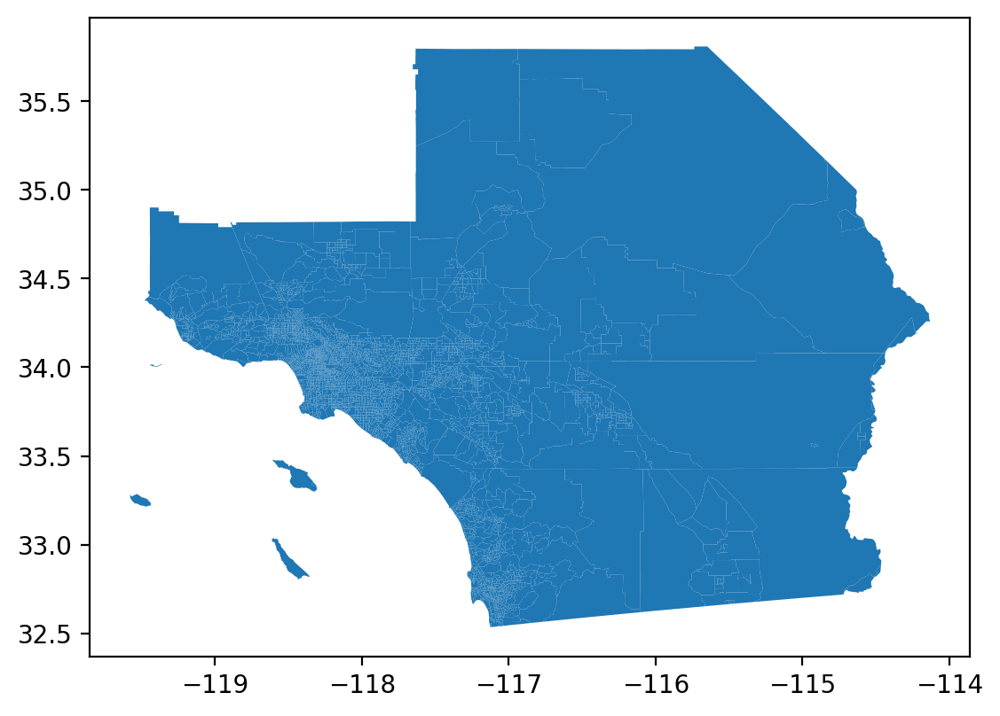

In [6]:
scag.plot()

In [12]:
la = scag[scag.geoid.str[:5] == "06037"]

In [8]:
wq = weights.Queen.from_dataframe(la)

/var/folders/79/cknfb1sx2pv16rztkpg6wzlw0000gn/T/ipykernel_23646/4114814998.py:1: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  wq = weights.Queen.from_dataframe(la)
/Users/knaaptime/mambaforge/envs/workshop-pysal-wrsa24/lib/python3.11/site-packages/libpysal/weights/weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


<Axes: >

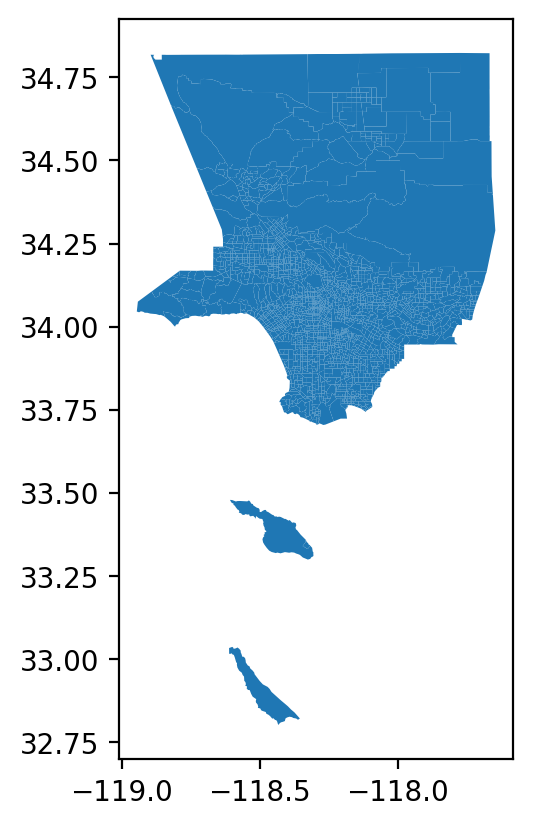

In [13]:
la.plot()

In [15]:
wq.component_labels

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [16]:
la = la.iloc[wq.component_labels == 0]

<Axes: >

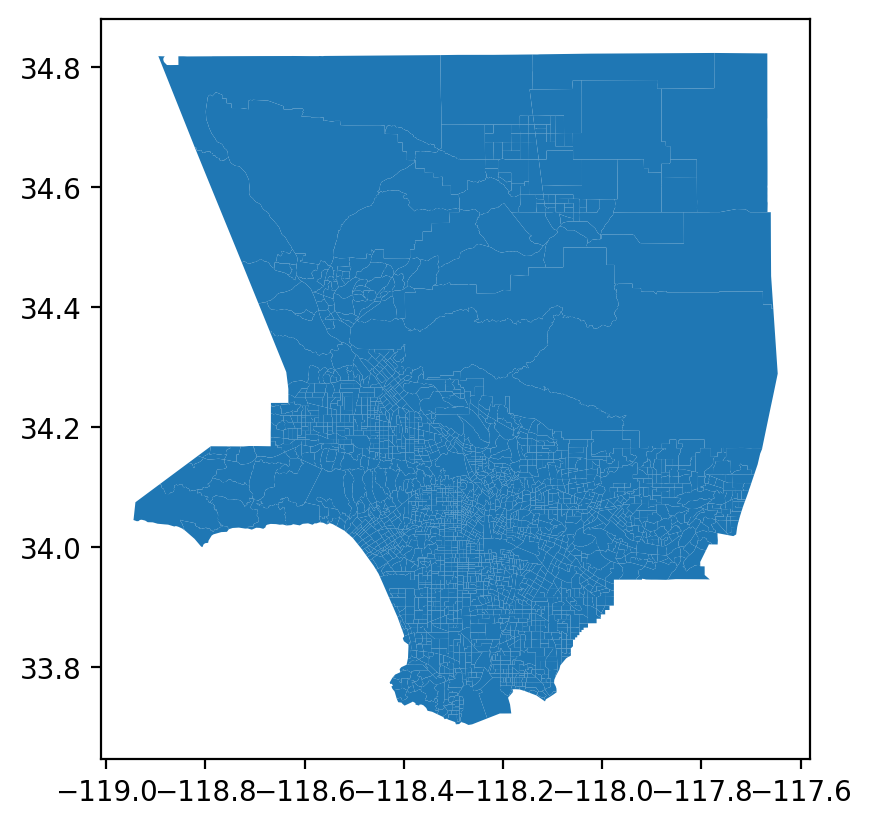

In [18]:
la.plot()

## Geodemographic Clusters

[Geodemographic analysis](https://en.wikipedia.org/wiki/Geodemographic_segmentation), which includes applying unsupervised learning to demographic and socioeconomic data, followed by a spatial analysis of the results

In [19]:
columns = [
    "median_household_income",
    "median_home_value",
    "p_asian_persons",
    "p_hispanic_persons",
    "p_nonhisp_black_persons",
    "p_nonhisp_white_persons",
]

In [20]:
scaler = StandardScaler()

In [21]:
la_kmeans = KMeans(n_clusters=6).fit(scaler.fit_transform(la[columns]))

In [22]:
la_kmeans.labels_

array([1, 2, 4, ..., 1, 0, 1], dtype=int32)

In [24]:
la["kmeans"] = la_kmeans.labels_

/Users/knaaptime/mambaforge/envs/workshop-pysal-wrsa24/lib/python3.11/site-packages/geopandas/geodataframe.py:1525: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [26]:
la.explore('kmeans', categorical=True, tooltip=columns)

In [27]:
la.hvplot(
    c="kmeans",
    cmap="tab10",
    line_width=0.1,
    alpha=0.7,
    geo=True,
    tiles="CartoLight",
    xaxis=False,
    yaxis=False,
    height=500,
    colorbar=False,
)

:Overlay
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]   (kmeans)

There are some obvious spatial patterns (which we might expect, given the results of our prior esda and segregation analyses). But what do these clusters mean? What kinds of demographic features do they represent?

In [28]:
la.groupby("kmeans")[columns].mean()

,median_household_income,median_home_value,p_asian_persons,p_hispanic_persons,p_nonhisp_black_persons,p_nonhisp_white_persons
kmeans,,,,,,
0,44664.764131,331908.717563,4.764191,83.322280,5.463539,5.568771
1,81372.953522,584261.777509,12.326483,21.650581,4.205080,58.092100
2,54608.684266,373428.416769,14.424606,48.289427,7.545298,24.165951
3,46622.259334,353954.775866,3.347498,39.136292,49.011830,5.636570
4,70091.807835,533738.987146,52.746342,25.961733,3.191891,15.698701
5,130480.570799,982882.139101,11.068841,9.091116,2.615798,73.485696


This table is a lot to interpret at once, so a visualization would be handy. Violin plots are a nice way of examining how each of the input variables is distributed in each of the resulting clusters

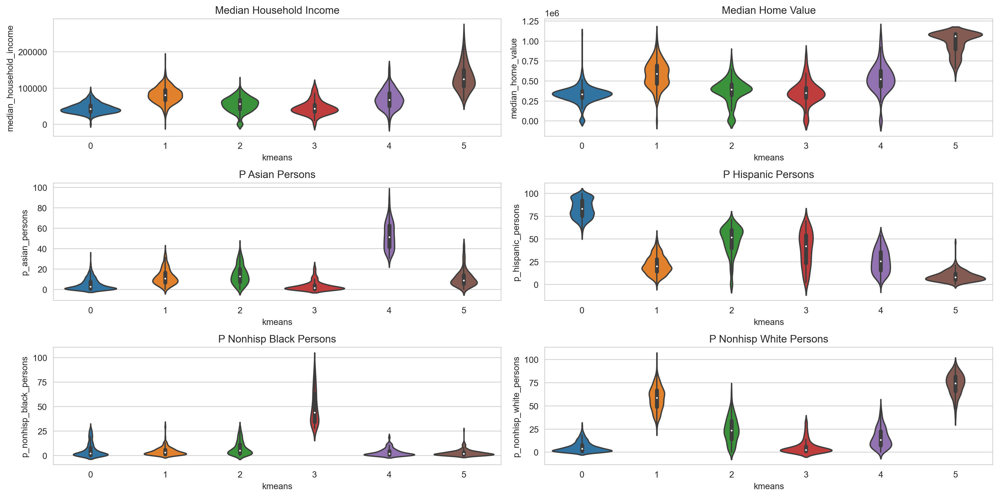

In [29]:
sns.set_style("whitegrid")
fig, ax = plt.subplots(3, 2, figsize=(16, 8))
ax = ax.flatten()
for i, col in enumerate(columns):
    sns.violinplot(data=la, y=col, x=la.kmeans, ax=ax[i])
    ax[i].set_title(col.replace("_", " ").title())
plt.tight_layout()

We can also use a statistic to tell us how well this model fits the data. To do so, we can use scikit-learn's [silhouette score](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.silhouette_score.html)

> The Silhouette Coefficient is calculated using the mean intra-cluster distance (a) and the mean nearest-cluster distance (b) for each sample. The Silhouette Coefficient for a sample is (b - a) / max(a, b). To clarify, b is the distance between a sample and the nearest cluster that the sample is not a part of. Note that Silhouette Coefficient is only defined if number of labels is 2 <= n_labels <= n_samples - 1.

> This function returns the mean Silhouette Coefficient over all samples. To obtain the values for each sample, use silhouette_samples.

> The best value is 1 and the worst value is -1. Values near 0 indicate overlapping clusters. Negative values generally indicate that a sample has been assigned to the wrong cluster, as a different cluster is more similar.

In [30]:
from sklearn.metrics import silhouette_score

In [31]:
silhouette_score(scaler.fit_transform(la[columns]), la_kmeans.labels_)

0.2917096598445249

What about other clustering algorithms or other numbers for *k*? Might we get a better model fit?

In [32]:
la_affprop = AffinityPropagation(
    damping=0.8,
    preference=-1000,
).fit(scaler.fit_transform(la[columns]))

In [33]:
la_affprop.labels_

array([1, 1, 0, ..., 1, 3, 1])

In [34]:
import pandas

pandas.Series(la_affprop.labels_).unique()

array([1, 0, 4, 2, 3])

In [35]:
silhouette_score(scaler.fit_transform(la[columns]), la_affprop.labels_)

0.36041919941486794

In [36]:
la["affprop"] = la_affprop.labels_

This will create a linked holoviews plot so we can zoom in on both maps together (**click the "wheel zoom" button on the bokeh plot so you can zoom in**)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
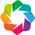

In [37]:
gv.extension("matplotlib", "bokeh")
gv.output(backend="bokeh")

In [38]:
la.hvplot(
    c="affprop",
    cmap="tab10",
    line_width=0.1,
    alpha=0.7,
    geo=True,
    tiles="CartoLight",
    xaxis=False,
    yaxis=False,
    colorbar=False,
    title="Affinity Prop",
) + la.hvplot(
    c="kmeans",
    cmap="tab10",
    line_width=0.1,
    alpha=0.7,
    geo=True,
    tiles="CartoLight",
    xaxis=False,
    yaxis=False,
    colorbar=False,
    title="K-Means",
)

:Layout
   .Overlay.I  :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .Polygons.I :Polygons   [Longitude,Latitude]   (affprop)
   .Overlay.II :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .Polygons.I :Polygons   [Longitude,Latitude]   (kmeans)

The silhouette score tells us that the affinity propagation clusterer provided a better solution. Nonetheless, we end up with similar spatial patterns

## Spatially-Constrained Geodemographics (Regionalization)

Above, we notice there are some obvious spatial patterns in the neighborhood clusters. That happens due to the underlying spatial autocorrelation in the race and class indicators we used to develop the clusters. Instead of allowing this autocorrelation to "fall out" of the results, we can leverage it to create spatially-contiguous clusters

`scikit-learn`'s agglomerative clustering algorithm allows us to pass a constraint and it accepts a pysal `W` object. Lets compare solutions with and without the constraint

In [39]:
w = weights.Queen.from_dataframe(la)

/var/folders/79/cknfb1sx2pv16rztkpg6wzlw0000gn/T/ipykernel_23646/1260691259.py:1: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = weights.Queen.from_dataframe(la)


In [40]:
la_ward = AgglomerativeClustering(n_clusters=8, linkage="ward").fit(
    scaler.fit_transform(la[columns])
)

In [41]:
la["ward"] = la_ward.labels_

In [42]:
la.groupby("ward")[columns].median()

,median_household_income,median_home_value,p_asian_persons,p_hispanic_persons,p_nonhisp_black_persons,p_nonhisp_white_persons
ward,,,,,,
0,58234.938202,4.082478e+05,13.006862,57.344708,3.104464,18.508217
1,121843.851124,1.088952e+06,8.052817,7.435296,1.749524,76.020506
2,85898.657303,6.101394e+05,12.389735,20.232354,2.826710,56.736570
3,55863.202247,2.659219e+05,6.707317,23.647554,5.884413,49.844042
4,42632.443820,3.266854e+05,2.596032,86.811146,1.379707,3.560149
5,71669.875000,5.563997e+05,58.589877,21.144737,1.311037,13.963383
6,40265.063670,3.183005e+05,3.785644,59.277575,23.795872,5.508182
7,48770.862360,3.718769e+05,1.736527,25.000000,58.754129,2.723888


In [43]:
sns.set_style("white")

In [46]:
la.plot("ward", categorical=True)

<Axes: >

In [47]:
_

<Axes: >

In [48]:
la_ward_spatial = AgglomerativeClustering(
    n_clusters=8, linkage="ward", connectivity=w.sparse
).fit(scaler.fit_transform(la[columns]))

In [50]:
la["ward_spatial"] = la_ward_spatial.labels_

In [51]:
la.hvplot(
    c="ward",
    cmap="tab10",
    line_width=0.1,
    alpha=0.7,
    geo=True,
    tiles="CartoLight",
    xaxis=False,
    yaxis=False,
    frame_height=450,
    colorbar=False,
) + la.hvplot(
    c="ward_spatial",
    cmap="tab10",
    line_width=0.1,
    alpha=0.7,
    geo=True,
    tiles="CartoLight",
    xaxis=False,
    yaxis=False,
    frame_height=450,
    colorbar=False,
)

:Layout
   .Overlay.I  :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .Polygons.I :Polygons   [Longitude,Latitude]   (ward)
   .Overlay.II :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .Polygons.I :Polygons   [Longitude,Latitude]   (ward_spatial)

In [52]:
silhouette_score(scaler.fit_transform(la[columns]), la_ward.labels_)

0.25095158588492034

In [53]:
silhouette_score(scaler.fit_transform(la[columns]), la_ward_spatial.labels_)

-0.04075640742151805

Why is the silhouette score higher for the first soluttion?

## Exercise

1. Two geodemographic typologies for Orange County using the same race and class variables as above
    - for the first, use 5 clusters
    - for the second, use 8 clusters
    - which solution is better?

2. Create a geodemographic typology for Riverside County using Affinity Propagation with `damping=0.8` and `preference=-100`
    - How many unique clusters do you find?
    - What is the average home price for tracts in Cluster 3?

3. What would happen if you created a spatially-constrained geodemographic typology using **DistanceBand**  spatial weights?

In [54]:
# %load solutions/05.py
##### 1)

# create orange county data
oc = scag[scag.geoid.str[:5] == '06059']

# create cluster models where k==5,8
oc5 = KMeans(n_clusters=5).fit(scaler.fit_transform(oc[columns]))
oc8 = KMeans(n_clusters=8).fit(scaler.fit_transform(oc[columns]))

# calculate silhouette coefs and print them
sil5 = silhouette_score(scaler.fit_transform(oc[columns]), oc5.labels_)
sil8 = silhouette_score(scaler.fit_transform(oc[columns]), oc8.labels_)

print(f'5-cluster solution: {sil5}')
print(f'8-cluster solution: {sil8}')


##### 2)

rside = scag[scag.geoid.str[:5] == '06065']

rside['affprop'] = AffinityPropagation(damping=0.8, preference=-100,).fit(scaler.fit_transform(rside[columns])).labels_
print(f'There are {len(rside.affprop.unique())} unique clusters in Riverside')

print(f"The average home price in cluster 3 is ${rside.groupby('affprop').mean()['median_home_value'][3].astype(int)}")

##### 3)

print("With distance band weights, the solution will be spatially-influenced but the clusters are not guaranteed to be contiguous")

